In [7]:
import sys
print(sys.version) # 3.6.8

3.6.8 (default, Dec 24 2018, 19:24:27) 
[GCC 5.4.0 20160609]


In [8]:
# import tensorflow as tf

# tf.enable_eager_execution()

In [901]:
import matplotlib.pyplot as plt
from matplotlib.colors import DivergingNorm, cnames

import numpy as np
import pandas as pd

import h5py

import pickle
import cv2
import os

import PIL
import time
import pathlib

from sklearn.decomposition import PCA, FastICA

from sklearn.linear_model import LinearRegression
from sklearn.metrics import explained_variance_score, r2_score

from pandas.plotting import scatter_matrix

from scipy.stats import gaussian_kde
from scipy.signal import find_peaks, argrelmax

from math import sqrt

from itertools import combinations, combinations_with_replacement

from cycler import cycler


from time import time

from matplotlib.ticker import NullFormatter
# from sklearn.manifold import TSNE
# from sklearn.cluster import OPTICS, cluster_optics_dbscan

from sklearn.cluster import Birch, MiniBatchKMeans, KMeans
from itertools import cycle

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.neighbors.nearest_centroid import NearestCentroid

from mpl_toolkits.mplot3d import Axes3D

from scipy.spatial import KDTree

In [10]:
pd.set_option('display.float_format', lambda x: '{:.3f}'.format(x))

df = pd.read_csv('/data/fp_tsne.csv')
df = df.set_index('ID')

display(df[:10])
# display(df.describe().T)

col_factors = ['factor{}'.format(i) for i in range(7)]
col_attributes = ['year',
                  'N_Housings', 'N_Units',
                  'Max_Floors', 'Min_Floors',
                  'Area', 
                  'Rooms', 'Baths']

,Unnamed: 0,true_year,prediction,row,factor0,factor1,factor2,factor3,factor4,factor5,...,sido_cluster,Area,norm_log_area,area_85,Entrance,Rooms,Baths,group_area,tsne0,tsne1
ID,,,,,,,,,,,,,,,,,,,,,
2829_105,0,0.520,0.564,0,0.611,1.785,-0.388,-0.324,0.403,-0.914,...,경기,84.690,-0.010,True,복도식,3,2,85m2,17.511,-49.942
999_37,1,0.360,0.407,1,-2.766,-0.138,-0.335,0.763,0.294,1.408,...,서울,27.610,-3.228,False,복도식,1,1,NaN,-34.132,-26.655
7770_55A,2,0.200,0.392,2,-4.549,0.465,1.008,-0.274,-0.669,-0.723,...,부산울산경남,41.520,-2.057,False,복도식,2,1,NaN,-49.837,-35.383
2140_92B,3,0.520,0.500,3,-0.829,1.609,0.456,-0.606,-0.178,0.384,...,경기,67.430,-0.665,False,계단식,3,1,60m2,-13.985,-55.294
509_73,4,0.500,0.486,4,-0.539,1.325,-0.499,0.784,0.302,-0.240,...,서울,52.470,-1.385,False,복도식,2,1,60m2,-9.185,-50.509
19478_113,5,0.740,0.750,5,-0.055,-0.499,0.356,-1.959,0.827,0.324,...,강원,84.710,-0.010,True,계단식,3,2,85m2,33.671,45.368
8657_70,6,0.360,0.408,6,-3.012,0.229,-0.304,-0.009,0.197,0.447,...,경기,53.190,-1.346,False,계단식,3,1,60m2,-37.420,-30.588
1856_61,7,0.400,0.461,7,-2.442,0.647,0.642,-0.463,0.314,0.458,...,경기,45.900,-1.769,False,계단식,3,1,60m2,-31.818,-42.848
25606_107C,8,0.740,0.726,8,0.198,0.026,0.414,-0.265,1.089,-2.190,...,경기,84.270,-0.025,True,계단식,3,2,85m2,24.476,11.676


In [71]:
df[col_factors].describe()

,factor0,factor1,factor2,factor3,factor4,factor5,factor6
count,50540.000,50540.000,50540.000,50540.000,50540.000,50540.000,50540.000
mean,-0.000,0.000,0.000,-0.000,0.000,0.000,-0.000
std,1.000,1.000,1.000,1.000,1.000,1.000,1.000
min,-5.706,-3.034,-50.346,-4.265,-6.852,-5.989,-2.324
25%,-0.115,-0.794,-0.175,-0.427,-0.498,-0.597,-0.585
50%,0.192,-0.295,0.079,0.113,0.121,0.014,-0.263
75%,0.518,0.945,0.335,0.588,0.657,0.575,0.195
max,8.992,2.902,2.597,3.586,3.161,5.242,6.914


In [115]:
X = df[col_factors]
X.corr()

,factor0,factor1,factor2,factor3,factor4,factor5,factor6
factor0,1.000,-0.000,-0.000,-0.000,0.000,0.000,0.000
factor1,-0.000,1.000,0.000,-0.000,-0.000,-0.000,-0.000
factor2,-0.000,0.000,1.000,0.000,-0.000,0.000,0.000
factor3,-0.000,-0.000,0.000,1.000,-0.000,-0.000,-0.000
factor4,0.000,-0.000,-0.000,-0.000,1.000,-0.000,0.000
factor5,0.000,-0.000,0.000,-0.000,-0.000,1.000,0.000
factor6,0.000,-0.000,0.000,-0.000,0.000,0.000,1.000


In [849]:
range_n_clusters = list(range(2, 400))

inertias = []
silhouettes = []
for n_clusters in range_n_clusters:
    t0 = time()
    
    model = MiniBatchKMeans(init='k-means++', n_clusters=n_clusters, batch_size=1000, random_state=1106)
    model.fit(X)
    
    labels = model.labels_
    
    inertias.append(model.inertia_)
    
    t1 = time()
    
    silhouette_avg = silhouette_score(X, labels, sample_size=5054, random_state=1106)
    silhouettes.append(silhouette_avg)
    
    t2 = time()

    print("For n_clusters =", n_clusters, 
          "The sum of square distances from center =", model.inertia_,
          "The average silhouette_score is :", silhouette_avg,
          f"Time: {t1-t0:0.2f}+{t2-t1:0.2f}")

For n_clusters = 2 The sum of square distances from center = 313812.9378178421 The average silhouette_score is : 0.16802229414488157 Time: 0.05+0.37
For n_clusters = 3 The sum of square distances from center = 280843.0199053005 The average silhouette_score is : 0.17873292682738634 Time: 0.05+0.37
For n_clusters = 4 The sum of square distances from center = 249149.05697165345 The average silhouette_score is : 0.20116364385468902 Time: 0.05+0.37
For n_clusters = 5 The sum of square distances from center = 220058.24646138222 The average silhouette_score is : 0.23212523683625258 Time: 0.06+0.37
For n_clusters = 6 The sum of square distances from center = 190565.43022489187 The average silhouette_score is : 0.24302125454593754 Time: 0.07+0.36
For n_clusters = 7 The sum of square distances from center = 166412.68539684667 The average silhouette_score is : 0.24665053602521053 Time: 0.06+0.37
For n_clusters = 8 The sum of square distances from center = 147468.45051154203 The average silhouette

For n_clusters = 57 The sum of square distances from center = 59252.81662783334 The average silhouette_score is : 0.14900525371046747 Time: 0.24+0.38
For n_clusters = 58 The sum of square distances from center = 58780.04273262575 The average silhouette_score is : 0.14792662811043336 Time: 0.33+0.38
For n_clusters = 59 The sum of square distances from center = 61006.828335998856 The average silhouette_score is : 0.14425449927175416 Time: 0.28+0.38
For n_clusters = 60 The sum of square distances from center = 59146.704568758294 The average silhouette_score is : 0.14197424744473058 Time: 0.33+0.38
For n_clusters = 61 The sum of square distances from center = 58145.21959506364 The average silhouette_score is : 0.14436218817649363 Time: 0.24+0.38
For n_clusters = 62 The sum of square distances from center = 57126.329646545804 The average silhouette_score is : 0.14942148845965872 Time: 0.34+0.38
For n_clusters = 63 The sum of square distances from center = 59240.51543253294 The average silho

For n_clusters = 112 The sum of square distances from center = 44985.32965214679 The average silhouette_score is : 0.12709077021749238 Time: 0.55+0.39
For n_clusters = 113 The sum of square distances from center = 45294.37717194534 The average silhouette_score is : 0.12916629887333278 Time: 0.49+0.38
For n_clusters = 114 The sum of square distances from center = 43981.143631221974 The average silhouette_score is : 0.1315143591068128 Time: 0.40+0.39
For n_clusters = 115 The sum of square distances from center = 44493.836369640005 The average silhouette_score is : 0.12312341043709797 Time: 0.40+0.39
For n_clusters = 116 The sum of square distances from center = 44604.97575615978 The average silhouette_score is : 0.13290692262466444 Time: 0.56+0.39
For n_clusters = 117 The sum of square distances from center = 44620.65319779129 The average silhouette_score is : 0.12675500507216741 Time: 0.61+0.39
For n_clusters = 118 The sum of square distances from center = 44279.522438407344 The average

For n_clusters = 167 The sum of square distances from center = 38518.564662579985 The average silhouette_score is : 0.11952102814233256 Time: 0.73+0.39
For n_clusters = 168 The sum of square distances from center = 38930.84470746664 The average silhouette_score is : 0.12044047386178666 Time: 1.60+0.39
For n_clusters = 169 The sum of square distances from center = 37303.810276946395 The average silhouette_score is : 0.12318192326672749 Time: 1.70+0.39
For n_clusters = 170 The sum of square distances from center = 37256.10217023001 The average silhouette_score is : 0.12390035173986344 Time: 1.81+0.39
For n_clusters = 171 The sum of square distances from center = 37059.96617012415 The average silhouette_score is : 0.12844334815229505 Time: 1.73+0.39
For n_clusters = 172 The sum of square distances from center = 36938.34017146705 The average silhouette_score is : 0.12251743835890856 Time: 1.73+0.39
For n_clusters = 173 The sum of square distances from center = 37242.70543095963 The average

For n_clusters = 222 The sum of square distances from center = 34076.186946915295 The average silhouette_score is : 0.11972325048222549 Time: 2.15+0.39
For n_clusters = 223 The sum of square distances from center = 33992.2537935082 The average silhouette_score is : 0.1102201832702845 Time: 0.89+0.39
For n_clusters = 224 The sum of square distances from center = 34008.544372906406 The average silhouette_score is : 0.11275278262502403 Time: 0.87+0.39
For n_clusters = 225 The sum of square distances from center = 34004.03846296103 The average silhouette_score is : 0.11265600775266522 Time: 0.88+0.39
For n_clusters = 226 The sum of square distances from center = 33830.85629166443 The average silhouette_score is : 0.11211184938386744 Time: 0.90+0.39
For n_clusters = 227 The sum of square distances from center = 33747.827703738665 The average silhouette_score is : 0.11235492293085428 Time: 0.89+0.39
For n_clusters = 228 The sum of square distances from center = 33729.36623488932 The average 

For n_clusters = 277 The sum of square distances from center = 30929.851404277502 The average silhouette_score is : 0.10609048310403972 Time: 1.04+0.39
For n_clusters = 278 The sum of square distances from center = 32363.922363460417 The average silhouette_score is : 0.10386925124560045 Time: 1.03+0.39
For n_clusters = 279 The sum of square distances from center = 30991.19903736163 The average silhouette_score is : 0.10489204262424495 Time: 1.01+0.39
For n_clusters = 280 The sum of square distances from center = 32305.195121569326 The average silhouette_score is : 0.10262334247302511 Time: 1.02+0.39
For n_clusters = 281 The sum of square distances from center = 30887.682959169986 The average silhouette_score is : 0.1035782674674031 Time: 1.08+0.39
For n_clusters = 282 The sum of square distances from center = 30790.799270190215 The average silhouette_score is : 0.1058379289640144 Time: 1.03+0.39
For n_clusters = 283 The sum of square distances from center = 30758.496181788712 The avera

For n_clusters = 332 The sum of square distances from center = 29038.25880589581 The average silhouette_score is : 0.0969953567138765 Time: 1.16+0.39
For n_clusters = 333 The sum of square distances from center = 29034.631178202275 The average silhouette_score is : 0.10027387648206747 Time: 1.17+0.39
For n_clusters = 334 The sum of square distances from center = 28907.605886500965 The average silhouette_score is : 0.09693159384003582 Time: 1.14+0.40
For n_clusters = 335 The sum of square distances from center = 28914.177003301018 The average silhouette_score is : 0.0963773655283802 Time: 1.16+0.39
For n_clusters = 336 The sum of square distances from center = 28937.263784089646 The average silhouette_score is : 0.10364869478005279 Time: 2.66+0.39
For n_clusters = 337 The sum of square distances from center = 28549.65283945449 The average silhouette_score is : 0.10607540301588941 Time: 1.69+0.39
For n_clusters = 338 The sum of square distances from center = 28838.30381502144 The average

For n_clusters = 387 The sum of square distances from center = 27593.349469190383 The average silhouette_score is : 0.08989296450333967 Time: 1.27+0.39
For n_clusters = 388 The sum of square distances from center = 27690.014975068123 The average silhouette_score is : 0.09347558560973993 Time: 1.26+0.39
For n_clusters = 389 The sum of square distances from center = 27514.489440949535 The average silhouette_score is : 0.09441487455074589 Time: 1.26+0.38
For n_clusters = 390 The sum of square distances from center = 27524.15381683609 The average silhouette_score is : 0.09487719498063658 Time: 1.28+0.39
For n_clusters = 391 The sum of square distances from center = 27508.050651649224 The average silhouette_score is : 0.09631281971150076 Time: 1.28+0.39
For n_clusters = 392 The sum of square distances from center = 27254.53929079511 The average silhouette_score is : 0.0972681927316367 Time: 1.84+0.39
For n_clusters = 393 The sum of square distances from center = 27546.228902394734 The avera

In [876]:
range_n_clusters

[2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22,
 23,
 24,
 25,
 26,
 27,
 28,
 29,
 30,
 31,
 32,
 33,
 34,
 35,
 36,
 37,
 38,
 39,
 40,
 41,
 42,
 43,
 44,
 45,
 46,
 47,
 48,
 49,
 50,
 51,
 52,
 53,
 54,
 55,
 56,
 57,
 58,
 59,
 60,
 61,
 62,
 63,
 64,
 65,
 66,
 67,
 68,
 69,
 70,
 71,
 72,
 73,
 74,
 75,
 76,
 77,
 78,
 79,
 80,
 81,
 82,
 83,
 84,
 85,
 86,
 87,
 88,
 89,
 90,
 91,
 92,
 93,
 94,
 95,
 96,
 97,
 98,
 99,
 100,
 101,
 102,
 103,
 104,
 105,
 106,
 107,
 108,
 109,
 110,
 111,
 112,
 113,
 114,
 115,
 116,
 117,
 118,
 119,
 120,
 121,
 122,
 123,
 124,
 125,
 126,
 127,
 128,
 129,
 130,
 131,
 132,
 133,
 134,
 135,
 136,
 137,
 138,
 139,
 140,
 141,
 142,
 143,
 144,
 145,
 146,
 147,
 148,
 149,
 150,
 151,
 152,
 153,
 154,
 155,
 156,
 157,
 158,
 159,
 160,
 161,
 162,
 163,
 164,
 165,
 166,
 167,
 168,
 169,
 170,
 171,
 172,
 173,
 174,
 175,
 176,
 177,
 178,
 179,
 180,
 181,
 182,
 183,
 184,
 185,
 1

In [877]:
inertias

[313812.9378178421,
 280843.0199053005,
 249149.05697165345,
 220058.24646138222,
 190565.43022489187,
 166412.68539684667,
 147468.45051154203,
 146030.62244837824,
 137733.8308486719,
 126437.1696764229,
 123466.7566983173,
 116595.71527766893,
 113321.17388276476,
 109475.04673880363,
 107585.32761386236,
 104706.36705658397,
 100203.46882263638,
 97301.31971096719,
 95971.91533976264,
 93836.86668343098,
 92233.39995324395,
 88802.16700364111,
 89672.29453182322,
 85098.06914794909,
 83380.47103592186,
 81691.28206221762,
 81329.45929196151,
 80236.40085409001,
 79159.2821340792,
 77903.68683026356,
 82862.76142959762,
 74307.09483114444,
 77358.34310247346,
 72531.03788724715,
 71865.63175475078,
 71024.37070174457,
 69964.5447390173,
 68961.877334456,
 68179.99956285882,
 67965.29783830351,
 66857.65103230545,
 66135.92952152618,
 65659.48303696243,
 65166.138051666305,
 64682.047546978945,
 64055.115939708885,
 63639.399860652484,
 63593.25844804688,
 62725.7089699775,
 62283.17

In [878]:
silhouettes

[0.16802229414488157,
 0.17873292682738634,
 0.20116364385468902,
 0.23212523683625258,
 0.24302125454593754,
 0.24665053602521053,
 0.26070954416578745,
 0.2474038929728479,
 0.2401719332113208,
 0.2215964618828496,
 0.22609965537906854,
 0.21615939392125433,
 0.20875620438082607,
 0.19897312088850272,
 0.1906094139878961,
 0.18620343215521512,
 0.19671215966842923,
 0.19318747212330065,
 0.198853592107789,
 0.17306739865818252,
 0.17790359270807407,
 0.1752554576406364,
 0.1697874688867116,
 0.17615365492202267,
 0.17205057410630653,
 0.17631685440995812,
 0.1694968454579031,
 0.17094559945491206,
 0.16463146454556943,
 0.16056047397991938,
 0.16633178622635772,
 0.16928178653731304,
 0.16142915527545704,
 0.16728242725783687,
 0.1641437859304871,
 0.16115431365911706,
 0.16187470023644962,
 0.16145175047167978,
 0.16217802094681086,
 0.15625341990979089,
 0.15984437907266036,
 0.15847614160387485,
 0.15826394005328642,
 0.15509001723310056,
 0.15729742010923178,
 0.1528337034473189,

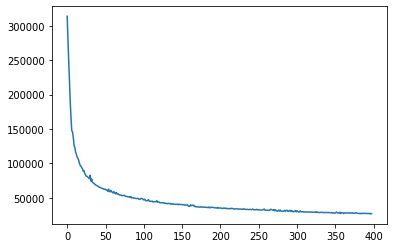

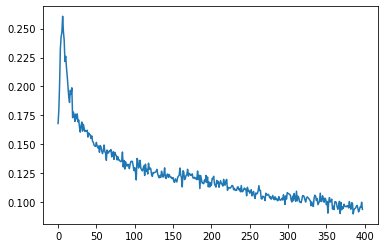

In [863]:
plt.plot(inertias)
plt.show()
plt.plot(silhouettes)
plt.show()

In [869]:
peaks, _ = find_peaks(np.array(silhouettes), distance=10, prominence=0.01)
peaks

array([  6,  18, 103, 118, 159, 169, 262, 311, 342, 354, 380])

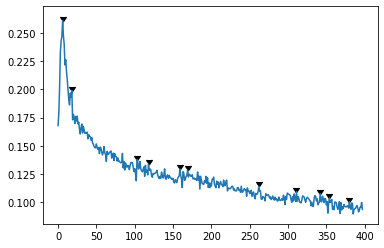

In [865]:
plt.plot(silhouettes)
plt.scatter(peaks, np.array(silhouettes)[peaks], marker=7, c='k')

[Text(-162468.45051154203, 0.26070954416578745, '$n=8$'),
 Text(-110971.91533976264, 0.198853592107789, '$n=20$'),
 Text(-52059.96617012415, 0.12844334815229505, '$n=171$')]

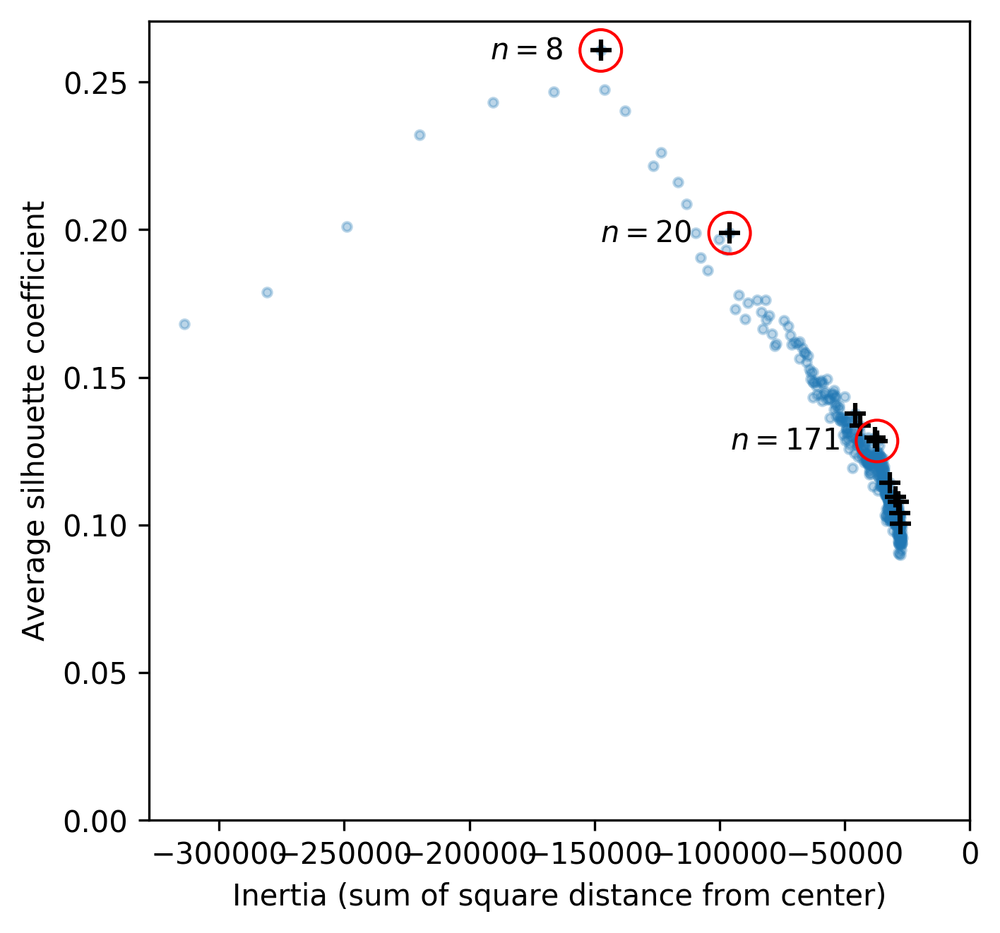

In [875]:
xs = -1*np.array(inertias)
ys = np.array(silhouettes)

picked_peaks = [0, 1, 5]

fig = plt.figure(figsize=(5, 5), dpi=300)
plt.scatter(xs, ys, marker='.', alpha=0.3)
plt.scatter(xs[peaks], ys[peaks], marker='+', s=50, c='k')
plt.scatter(xs[peaks[picked_peaks]], ys[peaks[picked_peaks]], marker='o', s=200, c='None', edgecolors='r')
plt.xlabel('Inertia (sum of square distance from center)')
plt.ylabel('Average silhouette coefficient')
plt.xlim(right=0)
plt.ylim(bottom=0)

ns = np.array(range_n_clusters)
[plt.text(x-15000, y, f'$n={n_cluster}$', ha='right', va='center')
 for x, y, n_cluster in zip(xs[peaks[picked_peaks]], ys[peaks[picked_peaks]], ns[peaks[picked_peaks]])]

In [900]:
picked_n_clusters = [8, 20, 171]

centers_list = []
for i, n_clusters in enumerate(picked_n_clusters):
    model = MiniBatchKMeans(init='k-means++', n_clusters=n_clusters, batch_size=1000, random_state=1106)
    model.fit(X)

    df[f'cluster{i}'] = model.labels_
    centers_list.append(model.cluster_centers_)
    
display(pd.DataFrame(centers_list[0]))

,0,1,2,3,4,5,6
0,-3.217,0.361,-0.270,-0.008,-0.003,0.005,-0.058
1,0.115,-0.532,0.125,-1.754,0.270,0.068,-0.522
2,0.003,0.102,-15.183,0.159,0.230,0.092,0.005
3,0.311,1.413,-0.077,0.035,0.255,0.407,-0.155
4,0.243,-0.470,-0.050,0.062,-0.014,-0.077,2.233
5,0.210,-0.848,0.132,0.573,0.405,0.380,-0.039
6,0.103,-0.188,0.193,0.357,-1.935,0.060,-0.411
7,0.275,-0.161,0.103,0.523,0.234,-1.307,-0.679


In [910]:
tree = KDTree(X)
closest_points_list = []
for centers in centers_list:
    print(tree.query(centers)[1])

[[...], [...], [...]]


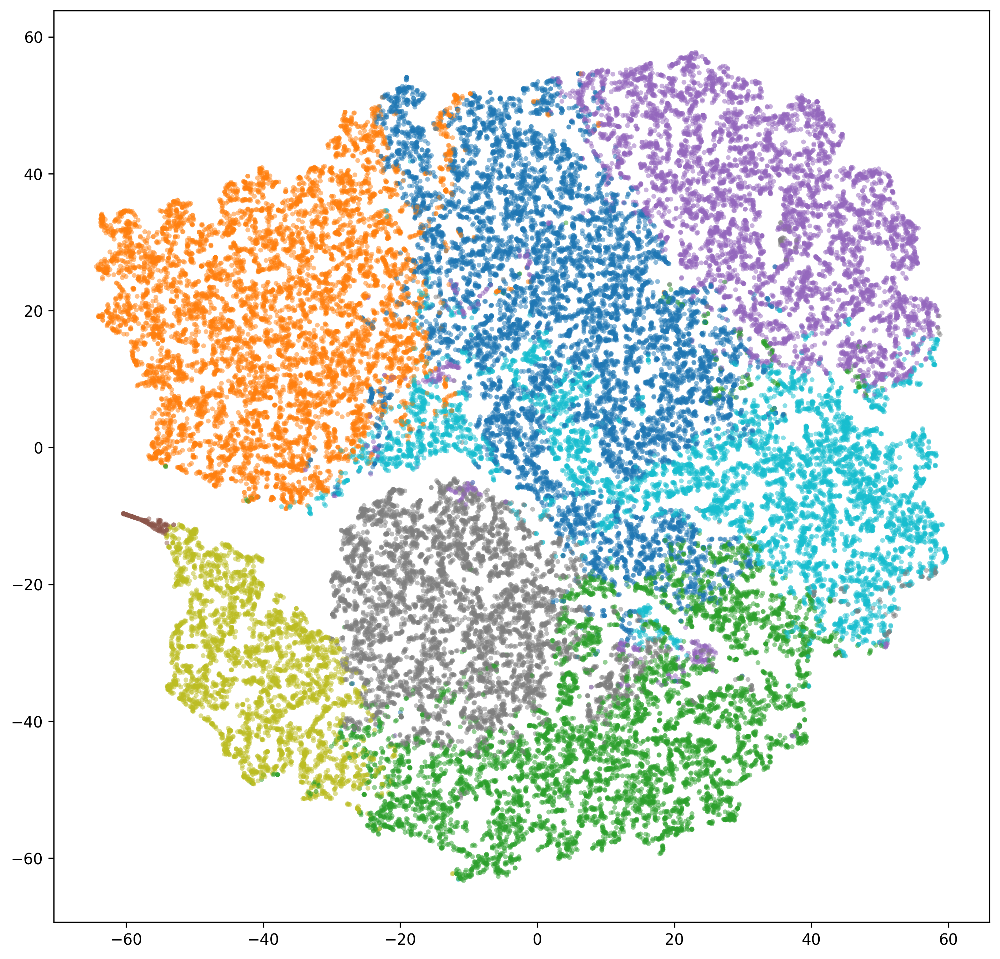

In [907]:
model = MiniBatchKMeans(init='k-means++', n_clusters=8, batch_size=501, random_state=1106)
model.fit(X)

labels = model.labels_
centroids = model.cluster_centers_ 
n_clusters = np.unique(labels).size

fig = plt.figure(figsize=(11, 11), dpi=300)
ax = fig.gca()
# ax.scatter(df['tsne0'], df['tsne1'], marker='.', s=40, c=labels, edgecolors='None', cmap=plt.get_cmap('tab10'), alpha=0.5)
ax.scatter(df['tsne0'].loc[, df['tsne1'], marker='.', s=40, c=labels, edgecolors='None', cmap=plt.get_cmap('tab10'), alpha=1)

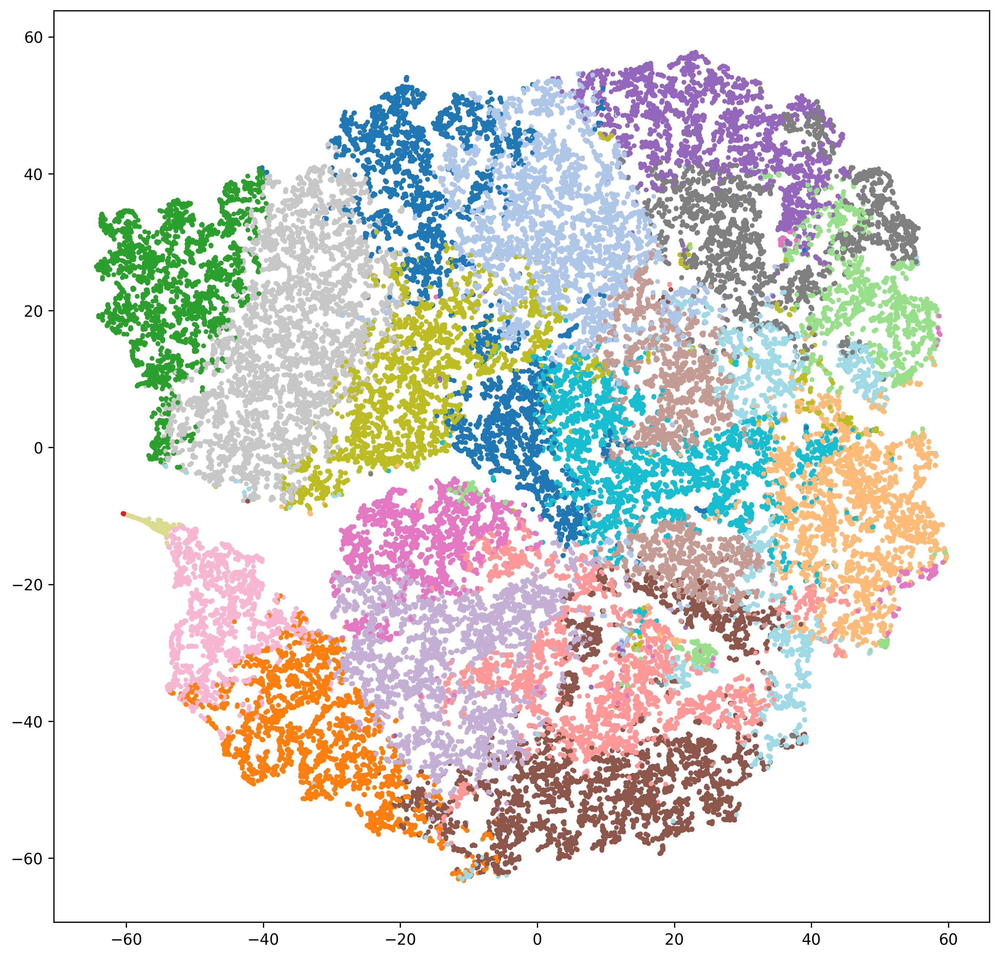

In [895]:
model = MiniBatchKMeans(init='k-means++', n_clusters=20, batch_size=501, random_state=1106)
model.fit(X)

labels = model.labels_
centroids = model.cluster_centers_ 
n_clusters = np.unique(labels).size

fig = plt.figure(figsize=(11, 11), dpi=300)
ax = fig.gca()
ax.scatter(df['tsne0'], df['tsne1'], marker='.', s=40, c=labels, edgecolors='None', cmap=plt.get_cmap('tab20'), alpha=1)

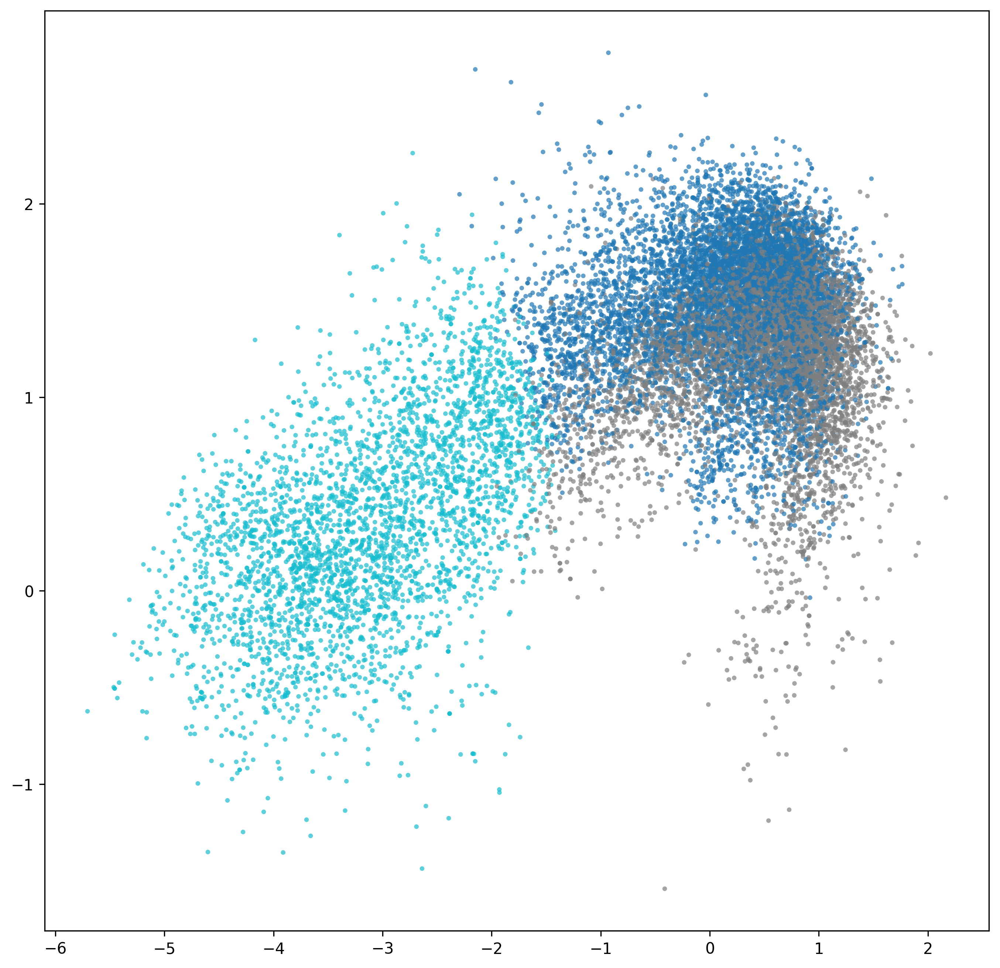

In [398]:
mask = (labels == 2) | (labels == 5) | (labels == 6)

fig = plt.figure(figsize=(11, 11), dpi=300)
ax = fig.gca()
ax.scatter(df['factor0'].loc[mask], df['factor1'].loc[mask],
           marker='.', 
           c=labels[mask], edgecolors='None', cmap=plt.get_cmap('tab10'),
           alpha=0.7)

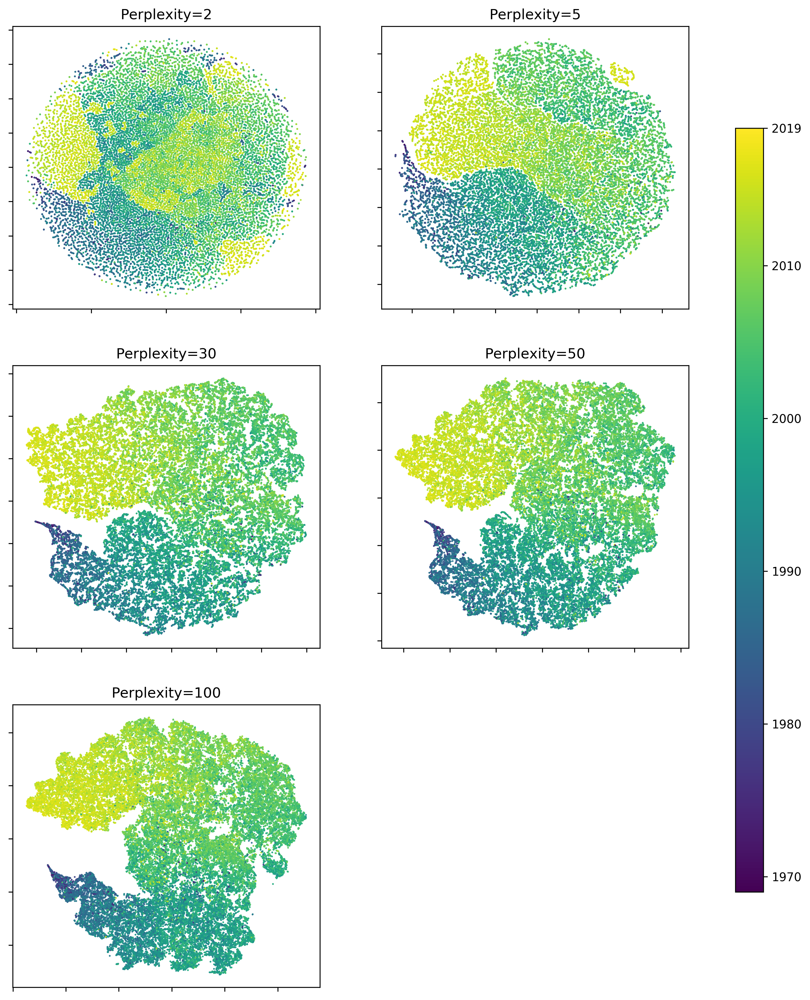

In [125]:
n_cols = 2
if len(perplexities) % n_cols:
    n_rows = len(perplexities)//n_cols + 1
else:
    n_rows = len(perplexities)//n_cols

fig, axes = plt.subplots(n_rows, n_cols, figsize=(11, 15), dpi=300)
axes = axes.flatten()
[axes[i].set_axis_off() for i in range(len(perplexities), len(axes))]

fig.subplots_adjust(right=0.85)

for i, perplexity in enumerate(perplexities):
    Y = ys[i]

    ax = axes[i]
    ax.set_title(f"Perplexity={perplexity}")
    ax.scatter(Y[:, 0], Y[:, 1], c=df['year'], marker='.', s=1)
    ax.xaxis.set_major_formatter(NullFormatter())
    ax.yaxis.set_major_formatter(NullFormatter())
    
    ax.set_aspect('equal')
    ax.axis('tight')
    
cbar_ax = fig.add_axes([0.90, 0.2, 0.03, 0.6])
cbar = fig.colorbar(ax.collections[0], cax=cbar_ax)
cbar.set_ticks(np.append(cbar.get_ticks(), df['year'].max()))

plt.show()
# too big for pdf
fig.savefig("tsne_by_perplexity.png")

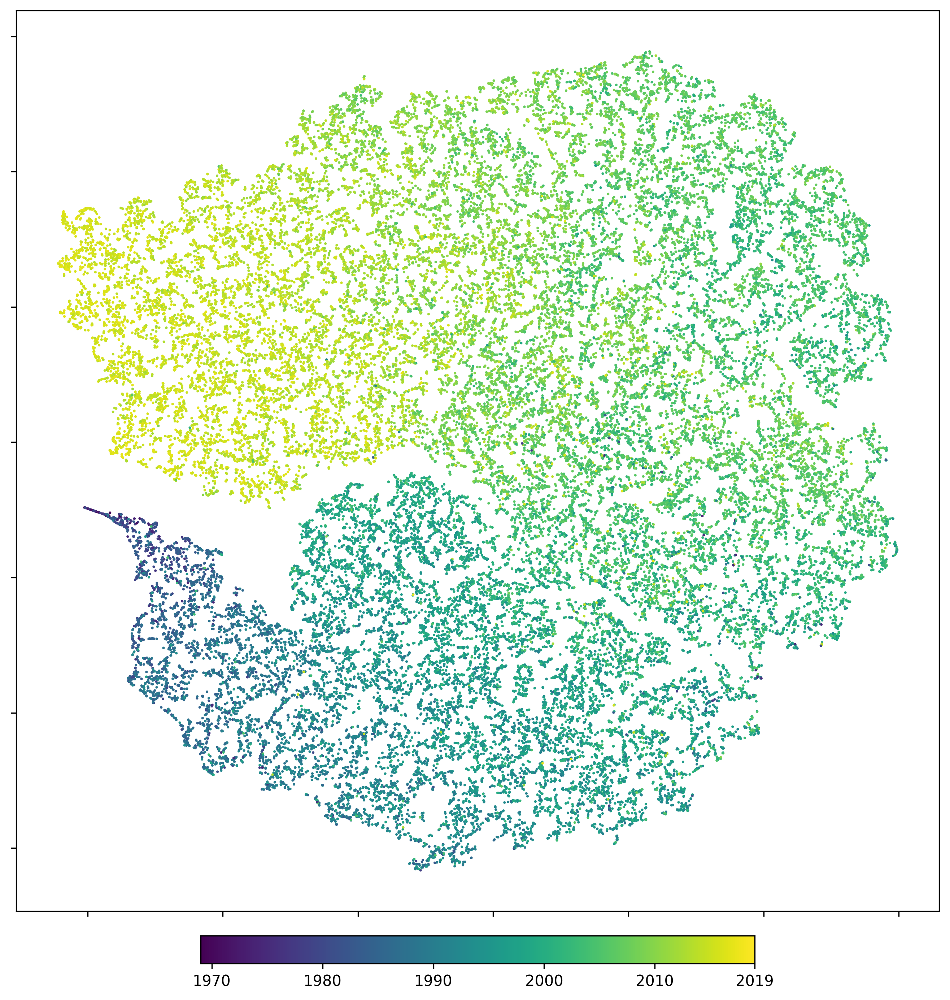

In [126]:
# perplexity 30
Y = ys[2] 

fig = plt.figure(figsize=(11, 15), dpi=300)
ax = fig.gca()
ax.scatter(df['tsne0'], df['tsne1'], c=df['year'], marker='.', s=2)
ax.xaxis.set_major_formatter(NullFormatter())
ax.yaxis.set_major_formatter(NullFormatter())
ax.set_aspect('equal')

cbar = fig.colorbar(ax.collections[0], ax=ax, 
                    orientation="horizontal", shrink=0.6, pad=0.02)
cbar.set_ticks(np.append(cbar.get_ticks(), df['year'].max()))

plt.show()
fig.savefig("tsne_big.png")

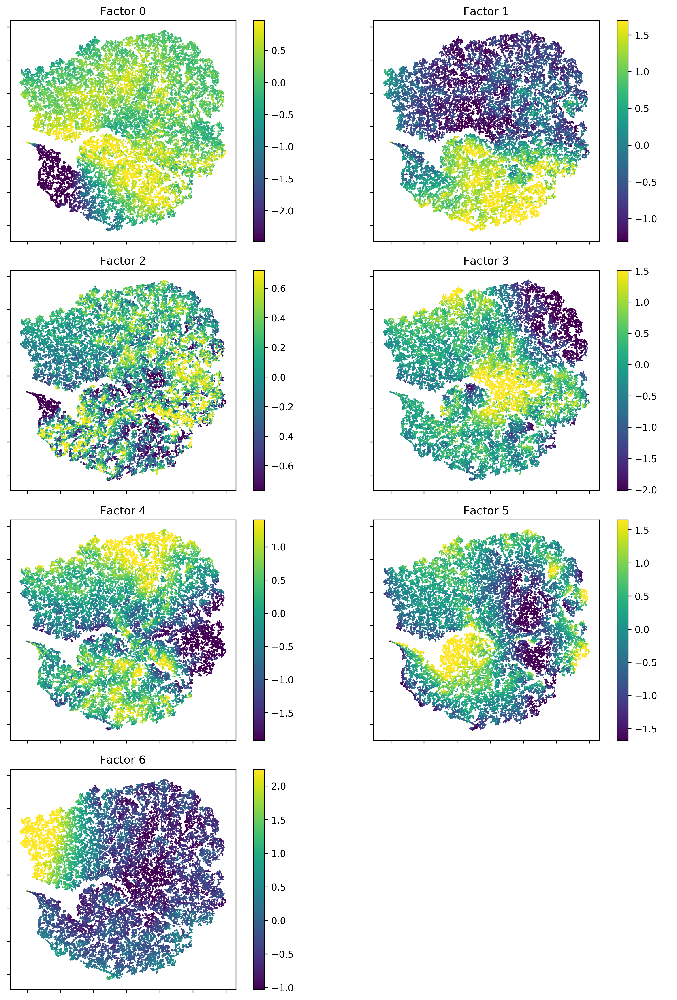

In [129]:
# colored by factors

# perplexity 30
Y = ys[2] 

n_cols = 2
if len(col_factors) % n_cols:
    n_rows = len(col_factors)//n_cols + 1
else:
    n_rows = len(col_factors)//n_cols

fig, axes = plt.subplots(n_rows, n_cols, figsize=(11, 15), dpi=300)
axes = axes.flatten()
[axes[i].set_axis_off() for i in range(len(col_factors), len(axes))]
    
for i, f in enumerate(col_factors):
    ax = axes[i]
    c = df[f]
    vmin, vmax = c.quantile([.05, .95])

    ax.scatter(Y[:, 0], Y[:, 1], c=c, marker='.', s=1,
               vmin=vmin, vmax=vmax)
    
    ax.set_title(f'Factor {i}')
    ax.xaxis.set_major_formatter(NullFormatter())
    ax.yaxis.set_major_formatter(NullFormatter())
    
    cbar = fig.colorbar(ax.collections[0], ax=ax)
#     cbar.set_ticks([-2, -1, 0, 1, 2])
    
    ax.axis('tight')
    ax.set_aspect('equal')

plt.tight_layout()
plt.show()
fig.savefig("tsne_by_factor.png")

In [130]:
# display(df.describe().T)

# perplexity 30
Y = ys[2] 

for i in range(2):
    df[f'tsne{i}'] = Y[:, i]
    
display(df.describe().T)

,count,mean,std,min,25%,50%,75%,max
Unnamed: 0,50540.000,25269.500,14589.786,0.000,12634.750,25269.500,37904.250,50539.000
true_year,50540.000,0.701,0.169,0.000,0.580,0.720,0.820,1.000
prediction,50540.000,0.700,0.153,-1.194,0.581,0.731,0.818,0.976
row,50540.000,25269.500,14589.786,0.000,12634.750,25269.500,37904.250,50539.000
factor0,50540.000,-0.000,1.000,-5.706,-0.115,0.192,0.518,8.992
factor1,50540.000,0.000,1.000,-3.034,-0.794,-0.295,0.945,2.902
factor2,50540.000,0.000,1.000,-50.346,-0.175,0.079,0.335,2.597
factor3,50540.000,-0.000,1.000,-4.265,-0.427,0.113,0.588,3.586
factor4,50540.000,0.000,1.000,-6.852,-0.498,0.121,0.657,3.161
factor5,50540.000,0.000,1.000,-5.989,-0.597,0.014,0.575,5.242
